<mark> <font size="3"> Suman Pan - 218352 </mark>


<mark> <font size="3"> Clara Llòria - 218147 </mark>

# Lab 4: The geometry of two views and 3D reconstruction

In this lab session, we are going to compute the 3D position of a pair of cameras and a set of keypoints.  For this, we will first compute correspondences between the two images.  Then, we will robustly compute the Fundamental matrix that encodes the geometry of the two views. From the Fundamental matrix and the camera calibration matrix -- that we learnt to estimate in the third lab session -- we will get the Essential matrix, which encodes the relative motion between the two cameras.  We will then compute the motion between the cameras and, finally, triangulate the matched keypoints to obtain their 3D position.

The goals of this lab assignment are the following:

- How to estimate the fundamental matrix that relates two images, corresponding to two different views of the same scene, given a set of correspondences between them. In particular, we will use the 8-point algorithm.

- How to compute the relative pose of two calibrated cameras

- How to triangulate point matches to reconstruct their 3D position.



In [4]:
import numpy as np
from numpy import linalg as LA
import cv2
import math
import sys
import random
import matplotlib
from matplotlib import pyplot as plt
from operator import itemgetter


from PIL import Image, ImageDraw, ImageOps
from utils import line_draw, plot_img#, compute_img_abs_conic, compute_K

from utils import plot_camera
import plotly.graph_objects as go    

## **1. Estimation of the fundamental matrix**

### **1.1 The 8-point algorithm**

The first task is to create the function that estimates the fundamental matrix given a set of point correspondences between a pair of images. We provide the incomplete function `fundamental_matrix` that computes,
with the normalised 8-point algorithm, an estimation of the Fundamental matrix
from a set of tentative point correspondences.  

**Q1.** Complete the function `fundamental_matrix` below.

In [5]:
def Normalization(x):

    x = np.asarray(x)
    x = x  / x[2,:]
    
    m, s = np.mean(x, 1), np.std(x)
    s = np.sqrt(2)/s;
 
    Tr = np.array([[s, 0, -s*m[0]], [0, s, -s*m[1]], [0, 0, 1]])


    xt = Tr @ x
        
    return Tr, xt

def fundamental_matrix(points1, points2):
    
    # Normalize points in both images
    T1, points1n = Normalization(points1)
    T2, points2n = Normalization(points2)
    
    p = points1n.shape[1]
    A= np.zeros([p,9])
    for i in range(p):
        x = points1n[0,i]
        y = points1n[1,i]
        x_p = points2n[0,i]
        y_p = points2n[1,i]  
        Ai = [x_p*x, x_p*y, x_p, y_p*x, y_p*y, y_p, x, y, 1]
        A[i,:] = Ai
    
    # Linear solution
    U, D, Vt = np.linalg.svd(A)
    F_bar = Vt[-1,:]
    F_bar = F_bar.reshape((3, 3))
    
    # Constraint enforcement
    U, D, Vt = np.linalg.svd(F_bar)
    D[2] = 0
    D_p = np.zeros([3,3])
    np.fill_diagonal(D_p, D)
    
    F_bar_p = np.dot(U, np.dot(D_p, Vt))
#     print('Det F_bar_p:',np.linalg.det(F_bar_p))
    F = np.dot(T2.T,np.dot(F_bar_p, T1))
    
    return F

**Q2.** Why do we need to enforce the rank 2 constraint?

<mark><font size=3>**Answer:**</mark>
    
    
In theory, $\mathbf{F}$ is a 3x3 homogeneous matrix, with rank 2. Since it is not a full rank matrix, it implies that it is singular and its determinant is zero, therefore with only 2 independent rows. 
    
We enforce the matrix $\mathbf{F}$ to have rank 2 constraint because we just need points of **2** **views** to build it, ie. given a scene point $X$ the $\mathbf{F}$ explains the mapping of the projected 2D point $x$ in the 1st view to its correspondence $x'$ in the 2nd view along the epipole line which satisfies $l=\mathbf{F}x$ that pass through the epipole of view 2, then we also have the relation of $x'\mathbf{F}x=0$. 

Extra Notes:
The rank of a matrix is the maximum number of independent rows (or, the maximum number of independent columns). A square matrix An×n is non-singular only if its rank is equal to n.
    
Reference:https://stackoverflow.com/questions/49763903/why-does-fundamental-matrix-have-7-degrees-of-freedom

The code below contains a toy example where we know the ground truth correspondences and ground-truth fundamental matrix. Use the code to test that the completed function is working properly.

In [10]:
# Two camera matrices for testing purposes
P1 = np.zeros((3,4))
P1[0,0]=P1[1,1]=P1[2,2]=1
angle = 15
theta = np.radians(angle)
c = np.cos(theta)
s = np.sin(theta)
R = np.array([[c, -s, 0], [s, c, 0], [0, 0, 1]])
t = np.array([[.3, .1, .2]])

P2 = np.concatenate((R, t.T), axis=1)
n = 8
rand = np.random.uniform(0,1,n)
rand = rand.reshape((1, n))
rand2 = np.random.uniform(0,1,2*n)
rand2 = rand2.reshape((2, n))
ones = np.ones((1,n))
X = np.concatenate((rand2, 3*rand, ones), axis=0)

x1_test = P1 @ X
x2_test = P2 @ X

print(x1_test)

[[0.80767666 0.85583426 0.52407211 0.14795831 0.39867686 0.47176828
  0.68175002 0.89730525]
 [0.02741673 0.92978992 0.40804206 0.58528745 0.24536605 0.31799699
  0.36130186 0.87858653]
 [1.57496747 0.45414697 1.70408831 1.86146382 0.86280288 0.75815296
  1.56863059 2.46412439]]


In [3]:
# Two camera matrices for testing purposes
P1 = np.zeros((3,4))
P1[0,0]=P1[1,1]=P1[2,2]=1
angle = 15
theta = np.radians(angle)
c = np.cos(theta)
s = np.sin(theta)
R = np.array([[c, -s, 0], [s, c, 0], [0, 0, 1]])
t = np.array([[.3, .1, .2]])

P2 = np.concatenate((R, t.T), axis=1)
n = 8
rand = np.random.uniform(0,1,n)
rand = rand.reshape((1, n))
rand2 = np.random.uniform(0,1,2*n)
rand2 = rand2.reshape((2, n))
ones = np.ones((1,n))
X = np.concatenate((rand2, 3*rand, ones), axis=0)

x1_test = P1 @ X
x2_test = P2 @ X

# Estimate fundamental matrix (you need to create this function)
F_es = fundamental_matrix(x1_test, x2_test)

# Ground truth fundamental matrix 
A = np.array([[0, -t[0,2], t[0,1]], [t[0,2], 0, -t[0,0]], [-t[0,1], t[0,0], 0]])
F_gt = A @ R

# Evaluation: these two matrices should be very similar
F_gt = np.sign(F_gt[0,0])*F_gt / LA.norm(F_gt)
F_es = np.sign(F_es[0,0])*F_es / LA.norm(F_es)
print("F_gt\n",F_gt)
print("F_es\n",F_es)
print("Error\n",LA.norm(F_gt-F_es))

F_gt
 [[ 0.0978244   0.36508565 -0.18898224]
 [-0.36508565  0.0978244   0.56694671]
 [ 0.03580622 -0.59654067 -0.        ]]
F_es
 [[ 9.78244040e-02  3.65085646e-01 -1.88982237e-01]
 [-3.65085646e-01  9.78244040e-02  5.66946710e-01]
 [ 3.58062170e-02 -5.96540671e-01 -3.18257704e-16]]
Error
 4.9457555591534546e-15


### **1.2 Robust estimation of the fundamental matrix**

The next step is to robustly compute the Fundamental matrix from the point correspondences. For that we will use the function `ransac_fundamental_matrix` that you have to complete.

The next code computes the image correspondences.

In [4]:
def compute_kp_des(img1_path,img2_path):

    # Read images
    img1 = cv2.imread(img1_path,cv2.IMREAD_GRAYSCALE) # 'Data/manikin1.jpg'
    img2 = cv2.imread(img2_path,cv2.IMREAD_GRAYSCALE) # 'Data/manikin2.jpg'

    # Initiate SIFT detector
    sift = cv2.SIFT_create(3000)

    # find the keypoints and descriptors
    kp1, des1 = sift.detectAndCompute(img1,None)
    kp2, des2 = sift.detectAndCompute(img2,None)

    # Keypoint matching
    bf = cv2.BFMatcher(cv2.NORM_L2, crossCheck=True)
    matches = bf.match(des1,des2)

    # Show matches
    img_12 = cv2.drawMatches(img1,kp1,img2,kp2,matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    
    return kp1, kp2, des1, des2, matches


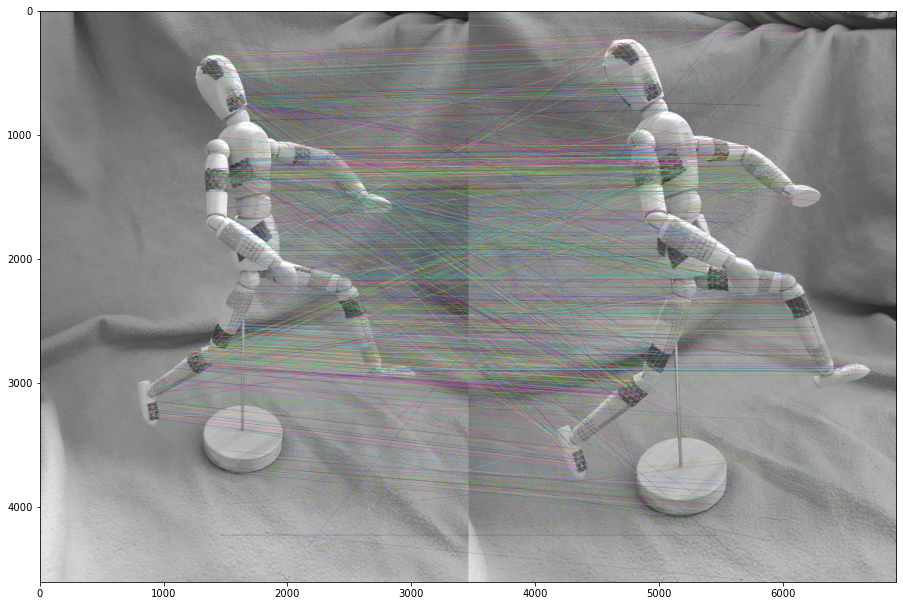

In [5]:
img1_path,img2_path = 'Data/manikin1.jpg','Data/manikin2.jpg'
kp1, kp2, des1, des2,matches = compute_kp_des(img1_path,img2_path)

**Q3.** A function `compute_inliers` is provided. How does it select the inliers? Explain also the error function used to find the inliers.

<mark><font size=3>**Answer**</mark>

The function selects the inliers by computing the distance  between points in image 1 and points in image 2 related by the fundamental matrix (just like homography matrix in Lab 2) with their respective projections in other view, and take this diference as the error, which have to be lower than a certain threshold.


**Q4.** Complete the function `ransac_fundamental_matrix` below. Which are the missing steps that needs to be added to the function? What is the difference with the RANSAC method used in the lab 3? 

<mark><font size=3>**Answer**</mark>

First, we need to compute F for each group of 8 random points, and then compute the inliers for that Fundamental Matrix. Once the inliers are taken, we need to check if the number of obtained points is greater than the best model so far. If it is the case, then this will be the new best model.
    
The difference between this method and the Ransac method used in Lab 3 is that we now use F instead of H (but their relation is very similar) since now we need 8 points (or 7 degrees of freedom more especifically), we have 8 unknowns as opposed to the other method where we had 4 unknowns.

In [6]:
def compute_inliers(F, x1, x2, th):
    
    Fx1 = F @ x1
    Ftx2 = F.T @ x2
    
    n = x1.shape[1]
    x2tFx1 = np.zeros((1, n))
 
    for i in range(n):
        x2t = x2[:,i]
        x2t = x2t.T
        x2tFx1[0,i] = x2t @ F @ x1[:,i]
    
    # evaluate distances
    
    den = Fx1[0,:]**2 + Fx1[1,:]**2 + Ftx2[0,:]**2 + Ftx2[1,:]**2
    den = den.reshape((1, n))
   
    d = x2tFx1**2 / den
    
    inliers_indices = np.where(d[0,:] < th)
    
    return inliers_indices[0]

def ransac_fundamental_matrix(points1, points2, th, max_it_0):
    
    Ncoords, Npts = points1.shape
    
    it = 0
    best_inliers = np.empty(1)
    max_it = max_it_0

    while it < max_it:
       
        indices = random.sample(range(1, Npts), 8)
        F = fundamental_matrix(points1[:, indices], points2[:, indices])
        inliers = compute_inliers(F, points1, points2, th)
        
        # test if it is the best model so far
        if (inliers.shape[0] > best_inliers.shape[0]):
            best_inliers = inliers
        
        # update estimate of iterations (the number of trials) to ensure we pick, with probability p, 
        # an initial data set with no outliers
        fracinliers = inliers.shape[0]/Npts
        pNoOutliers = 1 -  fracinliers**8
        eps = sys.float_info.epsilon
        pNoOutliers = max(eps, pNoOutliers)   # avoid division by -Inf
        pNoOutliers = min(1-eps, pNoOutliers) # avoid division by 0
        p = 0.99
        max_it = math.log(1-p)/math.log(pNoOutliers)
        if max_it > max_it_0:
            max_it = max_it_0

        it += 1
        
    # compute H from all the inliers
    F = fundamental_matrix(points1[:,best_inliers], points2[:,best_inliers])
    
    inliers = best_inliers
    
    print(it,inliers.shape[0])
    
    return F, inliers



In [7]:
# Robust estimation of the fundamental matrix

def robust_estimation_F(kp1, kp2, matches, img1_path,img2_path, th = 5, max_it = 5000):

    points1 = []
    points2 = []
    for m in matches:
        points1.append([kp1[m.queryIdx].pt[0], kp1[m.queryIdx].pt[1], 1])
        points2.append([kp2[m.trainIdx].pt[0], kp2[m.trainIdx].pt[1], 1])

    points1 = np.asarray(points1)
    points1 = points1.T
    points2 = np.asarray(points2)
    points2 = points2.T

    F, indices_inlier_matches = ransac_fundamental_matrix(points1, points2, th, max_it)
    inlier_matches = itemgetter(*indices_inlier_matches)(matches)

    img1 = cv2.imread(img1_path) # 'Data/manikin1.jpg'
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    img2 = cv2.imread(img2_path)
    img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

    img_12 = cv2.drawMatches(img1,kp1,img2,kp2,inlier_matches,None,flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS)
    plt.imshow(img_12)
    fig = matplotlib.pyplot.gcf()
    fig.set_size_inches(18.5, 10.5)
    plt.show()
    
    return F, indices_inlier_matches, points1, points2

5000 399


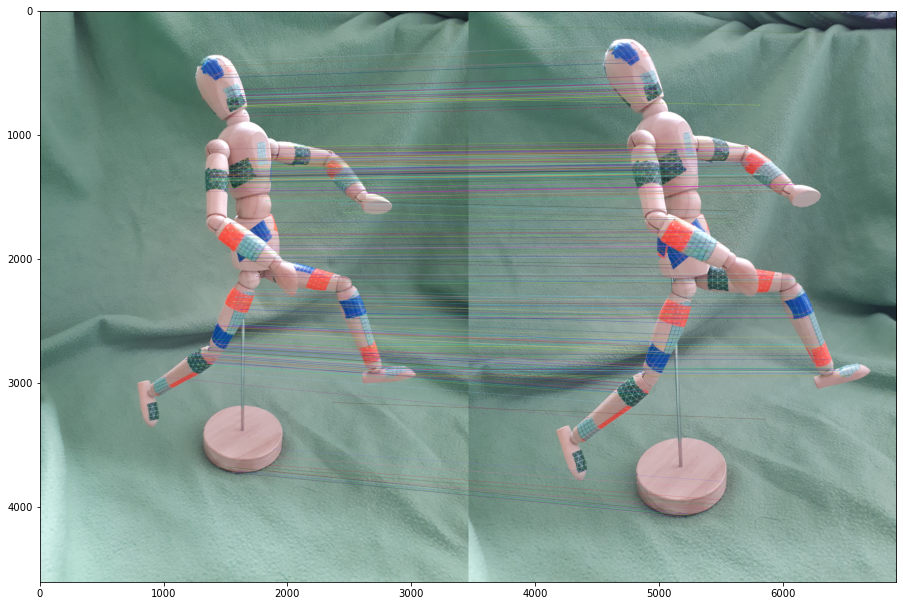

In [8]:
F, indices_inlier_matches, points1, points2 = robust_estimation_F(kp1, kp2, matches, img1_path, img2_path)

### **1.3 Epipolar lines**

We will now visualize the epipolar lines associated to some points.

**Q5.** Choose 3 inlier points in the first image and compute their corresponding epipolar lines (in homogeneous coordinates) in the second image. Do the same but now choosing points in the second image and showing their epipolar lines in the first image. Provide the commands you used for that. The commands for showing the lines on top of the image are already provided.


**Q6.** Compute the epipoles from the Fundamental matrix. Compute the epipolar lines as the line that passes through the matching point and the epipole. Check that you obtain the same epipolar lines as before. Do the same with the images taken with your own camera during the lab session.

In [9]:
# Choose three 3 random indices, using the indices of the inlier matches

def choose_random_idx(indices_inlier_matches):

    N = indices_inlier_matches.shape[0]
    indices = random.sample(range(1, N), 3)
    # print("N",N)
    # print("indices",indices)
    m1 = indices_inlier_matches[indices[0]]
    m2 = indices_inlier_matches[indices[1]]
    m3 = indices_inlier_matches[indices[2]]

    # print("m1,m2,m3",m1,m2,m3)
    return m1, m2, m3

In [10]:

m1, m2, m3 = choose_random_idx(indices_inlier_matches)

In [11]:
# Subplots for the 1st case
def show_subplot(l1,l2,m1,m2,m3, points1, points2, img1_path,img2_path):

    fig, (ax1, ax2) = plt.subplots(1, 2)
    fig.set_size_inches(18.5, 10.5)
    fig.suptitle('Epipolar lines ')


    I = Image.open(img1_path)
    I = I.rotate(-90, expand=True)
    size = I.size
    canv = ImageDraw.Draw(I)
    line_draw(l1[:,m1], canv, size)
    line_draw(l1[:,m2], canv, size)
    line_draw(l1[:,m3], canv, size)
    canv.ellipse((round(points1[0,m1]), round(points1[1,m1]), round(points1[0,m1])+15, round(points1[1,m1])+15), fill = 'yellow', outline ='yellow')
    canv.ellipse((round(points1[0,m2]), round(points1[1,m2]), round(points1[0,m2])+15, round(points1[1,m2])+15), fill = 'yellow', outline ='yellow')
    canv.ellipse((round(points1[0,m3]), round(points1[1,m3]), round(points1[0,m3])+15, round(points1[1,m3])+15), fill = 'yellow', outline ='yellow')
    ax1.set_title('Image 1')
    ax1.imshow(I)

    I2 = Image.open(img2_path)
    I2 = I2.rotate(-90, expand=True)
    size = I2.size #(3456, 4608)
    canv2 = ImageDraw.Draw(I2)
    line_draw(l2[:,m1], canv2, size)
    line_draw(l2[:,m2], canv2, size)
    line_draw(l2[:,m3], canv2, size)
    canv2.ellipse((round(points2[0,m1]), round(points2[1,m1]), round(points2[0,m1])+15, round(points2[1,m1])+15), fill = 'yellow', outline ='yellow')
    canv2.ellipse((round(points2[0,m2]), round(points2[1,m2]), round(points2[0,m2])+15, round(points2[1,m2])+15), fill = 'yellow', outline ='yellow')
    canv2.ellipse((round(points2[0,m3]), round(points2[1,m3]), round(points2[0,m3])+15, round(points2[1,m3])+15), fill = 'yellow', outline ='yellow')
    ax2.imshow(I2)

    ax2.set_title('Image 2')
    plt.show()
    
    return I,I2

In [12]:
def get_epipolar_lines(F, points1, points2):

    # Epipolar lines for all points 
    l2 = np.dot(F, points1)
    l1 = np.dot(F.T,points2)
    
    return l2, l1

def get_epipolar_lines_from_e(F, points1, points2):

    # Compute Epipole
    u, s, vh  = np.linalg.svd(F)
    e_p = u[:,-1] # left
    e = vh[-1,:] # right
    
#     print(np.dot(F,e))
#     print(np.dot(e_p.T,F))

    l2_e = []; l1_e = []
    for i in range(points1.shape[1]):
        l2_e.append(np.cross(e_p, points2[:,i]))
        l1_e.append(np.cross(e, points1[:,i]))

    l2_e=np.asarray(l2_e).T
    l1_e=np.asarray(l1_e).T
    
    return l2_e, l1_e


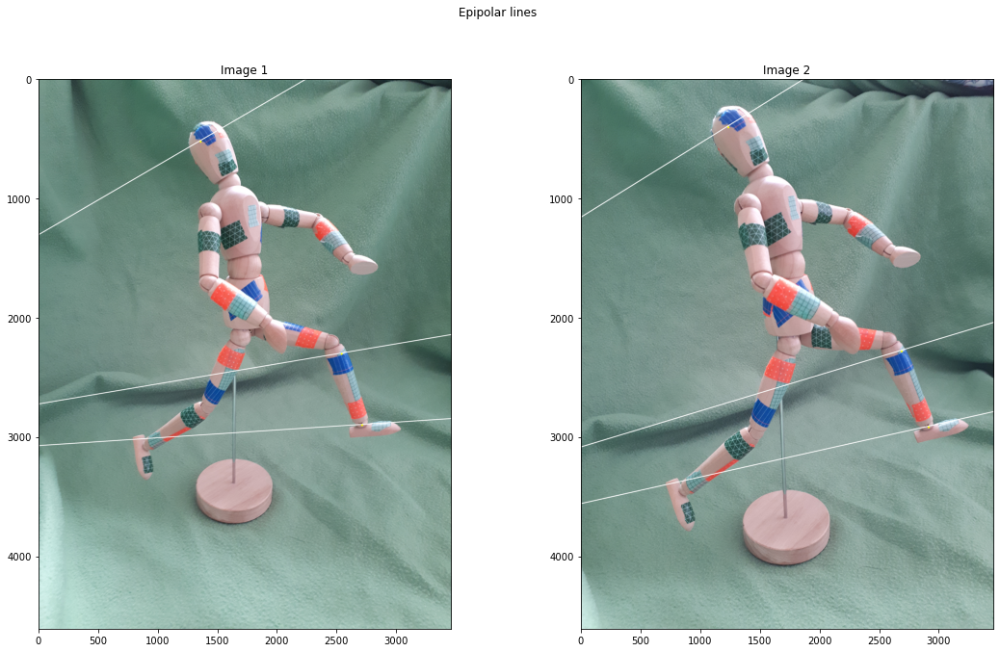

In [13]:
l2, l1 = get_epipolar_lines(F, points1, points2)

# show plots
I,I2 = show_subplot(l1,l2,m1,m2,m3, points1, points2, img1_path, img2_path)

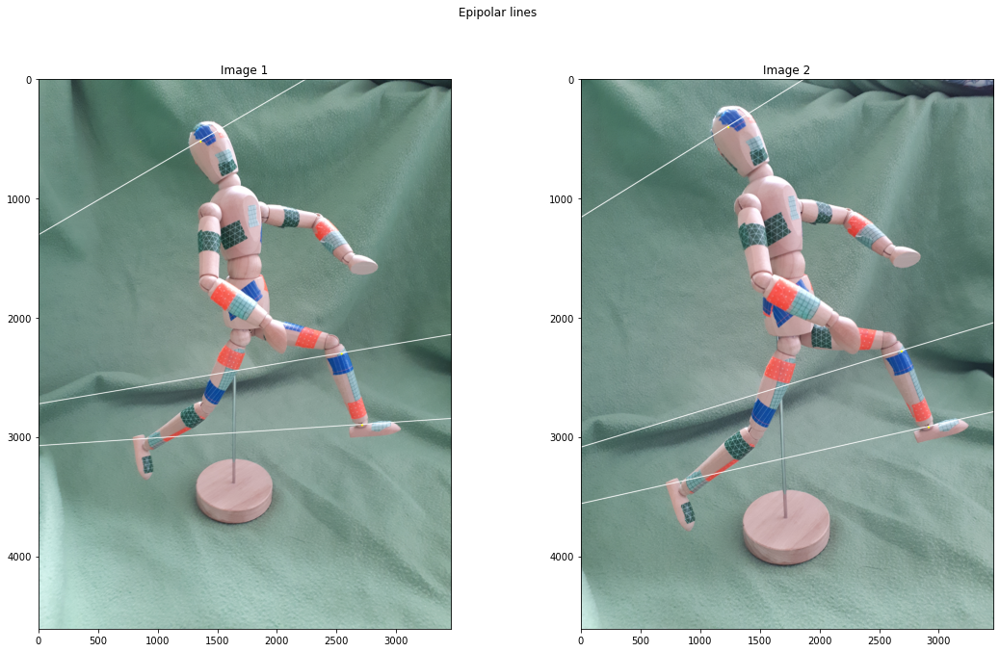

In [14]:
# img1_path,img2_path = 'Data/manikin1.jpg','Data/manikin2.jpg'

l2_e, l1_e = get_epipolar_lines_from_e(F, points1, points2)

# show plots
I,I2 = show_subplot(l1_e,l2_e,m1,m2,m3, points1, points2, img1_path, img2_path)

### Using our own images

<mark><font size = 3>**Answer**</mark>
    
We decided to compute all the method for our own images in the last part of this lab to make the reading easier and to avoid overwriting variables. 

## 2. Structure computation

### **2.1 Triangulation**

Before recovering the camera motion, we will first need to implement a function to triangulate matches.  This is a function that takes as input a match and the projection matrices of two cameras, and computes the 3D position of a match.

We want then to find the 3D point $\mathbf{X}$ such that its projection onto the images are $\mathbf{x} = P \mathbf{X}$ and $\mathbf{x'} = P' \mathbf{X}$ (being $P$ and $P'$ the projection matrices of each camera).

**Q7.** Derive the system equations in the matrix form $A \mathbf{X} = \mathbf{0}$ that we need to solve in order to estimate the homogeneous coordinates of the 3D point $\mathbf{X}$.

<mark><font size = 3>**Answer**</mark>

To estimate the homogeneous coordinates of the triangulated 3D point X, we need to solve the following system of equations: $A \mathbf{X} = \mathbf{0}$

The main idea behind this is the relationship about a point in 3D and its projection in 2D, $x = PX$ and therefore that $x = \alpha PX$. Also, by knowing that the product of two vectors with same direction is zero, we can say that $x \times PX = 0$, which removes the scale factor.

By developing this expression we get that 
$$\begin{pmatrix}
x\\ 
y\\ 
1
\end{pmatrix} \times
\begin{pmatrix}
p_1^TX\\ 
p_2^TX\\ 
p_3^TX
\end{pmatrix} = 
\begin{pmatrix}
yp_3^TX-p_2^TX\\ 
p_1^TX-xp_3^TX\\ 
xp_2^TX-yp_1^TX
\end{pmatrix} = 
\begin{pmatrix}
0\\ 
0\\ 
0
\end{pmatrix}  $$
    
Then, by taking two rows from camera one and two rows from camera two, the expression can be rewriten as, $A \mathbf{X} = \mathbf{0}$ where, 

$$ A_i = 
\begin{pmatrix}
xp_3^T - p_1^T\\ 
yp_3^T - p_2^T\\ 
x{'}p{'}_3^T - p{'}_1^T\\ 
y'p{'}_3^T - p{'}_2^T
\end{pmatrix} $$
$i=1,...,8$
    
Finally, to find the solution to the system of equations we need to compute the singular vector associated to the minimum singular value of A by SVD decomposition.

**Q8.** Complete the code of the `triangulate`function below.

In [15]:
def triangulate(x1, x2, P1, P2, imsize):
    
    # only one point
    if x1.ndim == 1:
        x1 = np.array([x1]).T
        x2 = np.array([x2]).T

    # number of points
    n = x1.shape[1]

    # Normalization
    x1 = x1/x1[2,:]
    x2 = x2/x2[2,:]

    nx = imsize[0];
    ny = imsize[1];

    H = [[2/nx,  0,     -1],
        [0,      2/ny,  -1],
        [0,      0,      1]]

    x1_norm = H @ x1
    x2_norm = H @ x2
    P1_norm = H @ P1
    P2_norm = H @ P2
    
    # we dont have to denormalize, since we are just modifying the equation not the interest points X
    # that is, transforming it back using H^-1
    
    num_points = x1_norm.shape[1]
    X = np.zeros((4,num_points))
    for i in range(num_points): #8 points
        # first view
        a1= x1_norm[0,i] * P1_norm[2,:] - P1_norm[0,:] 
        a2= x1_norm[1,i] * P1_norm[2,:] - P1_norm[1,:]
        # second view
        a3= x2_norm[0,i] * P2_norm[2,:] - P2_norm[0,:] 
        a4= x2_norm[1,i] * P2_norm[2,:] - P2_norm[1,:]
        

        Ai = np.asarray([a1,a2,a3,a4]) # 4x4
        
        u,s,vh = np.linalg.svd(Ai)
        xi = vh[-1,:] #last row

        X[:,i]=xi
    
    # normalization of X to homogeneous space
    X /= X[-1, :]

    return X

You may use the following test code with a toy example to validate that the `triangulate`function is working properly.

In [16]:
# Two camera matrices for testing purposes
P1 = np.zeros((3,4))
P1[0,0]=P1[1,1]=P1[2,2]=1
angle = 15
theta = np.radians(angle)
c = np.cos(theta)
s = np.sin(theta)
R = np.array([[c, -s, 0], [s, c, 0], [0, 0, 1]])
t = np.array([[.3, .1, .2]])

P2 = np.concatenate((R, t.T), axis=1)
n = 8
rand = np.random.uniform(0,1,n)
rand = rand.reshape((1, n))
rand2 = np.random.uniform(0,1,2*n)
rand2 = rand2.reshape((2, n))
ones = np.ones((1,n))
X = np.concatenate((rand2, 3*rand, ones), axis=0)

x1_test = P1 @ X
x2_test = P2 @ X

# Estimate the 3D points (you need to create this function)
x_trian = np.zeros((4, n))
x_trian = triangulate(x1_test, x2_test, P1, P2, ((2,2)));

# Evaluation: compute the reprojection error
x_eucl = x_trian / x_trian[3][np.newaxis]
X_eucl = X / X[3][np.newaxis]

diff = X_eucl - x_eucl
print("Diff of X est and GT \n",diff)
print("Diff of X est and GT SUM TOTAL \n",np.sum(diff))

Diff of X est and GT 
 [[-1.44328993e-15 -1.66533454e-16 -4.10782519e-15 -1.38777878e-16
   1.66533454e-16  1.11022302e-16 -4.16333634e-16 -1.94289029e-16]
 [-7.77156117e-16  5.55111512e-17 -2.55351296e-15 -2.22044605e-16
   3.33066907e-16  2.91433544e-16 -1.11022302e-16 -1.22124533e-15]
 [-3.99680289e-15 -4.44089210e-16 -8.88178420e-15 -2.22044605e-16
   1.11022302e-15  4.44089210e-16 -2.22044605e-15 -1.33226763e-15]
 [ 0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00
   0.00000000e+00  0.00000000e+00  0.00000000e+00  0.00000000e+00]]
Diff of X est and GT SUM TOTAL 
 -2.593758541280522e-14


### 2.2 Relative motion between the two cameras
As seen in the theory class, the relative position between the cameras can be computed from the Essential matrix, $E$. In order to estimate $E$, we need the Fundamental matrix, $F$, that we have just computed and the camera calibration matrix, $K$, that we learnt how to estimate during the third session.

**Q9.** Compute the Essential matrix from the Fundamental matrix and the camera calibration matrix in the code below.

Computation of E:


In [17]:

def compute_E(F, K, K_p=None):
    if not K_p.all():
        K_p = K
    E = np.dot(K_p.T, np.dot(F,K))
#     print(E)
    return E

In [18]:
# K matrix estimated in lab 3 (you can use this one or the one you obtained)
K = np.array([[3531.97, 9.59, 2304.33], [0, 3537.34, 1751.75], [0, 0, 1]]) 

K_p = K # we assume the intrinsic matrix K of two cameras has the same values
E = compute_E(F, K, K_p)

We will assume that the first camera is at the origin, with no rotation, and that the second camera has a rotation and translation with respect to the first one.

**Q10.** Write the camera projection matrix $P$ for the first camera.

In [19]:
def compute_P1(K):
    zero_vec = np.zeros([1,3])
    I_m = np.identity(3)
    P_bar = np.concatenate([I_m,zero_vec.T], axis = 1)
    P1 = np.dot(K, P_bar) # camera 1
#     print(P1)
    return P1

In [20]:
P1 = compute_P1(K)

The rotation and translation of the second camera can be computed from the SVD decomposition of $E$. There are four possible solutions.

**Q11.** Complete the code below to compute the four candidate solutions for the second camera projection matrix.

In [21]:
def compute_P2(E, K):
    U,D,VT = LA.svd(E)

    # The SVD of E has several ambiguities.  In particular, U and V may be
    # improper rotations in which case we need to change their sign.
    if LA.det(U) < 0:
        U = -U

    if LA.det(VT) < 0:
        VT = -VT

    # four camera projection matrices for the second camera
    W = np.asarray([[0, -1, 0], [1, 0, 0], [0, 0, 1]])

    Pc2 = np.empty(shape=(4,3,4))
    UWVT =  np.dot(U,np.dot(W, VT))
    UWTVT = np.dot(U,np.dot(W.T, VT))

    Pc2[0] = np.dot(K, np.concatenate((UWVT, U[:,-1,np.newaxis]), axis = 1))
    Pc2[1] = np.dot(K, np.concatenate((UWVT, -U[:,-1,np.newaxis]), axis = 1))

    Pc2[2] = np.dot(K, np.concatenate((UWTVT, U[:,-1,np.newaxis]), axis = 1))
    Pc2[3] = np.dot(K, np.concatenate((UWTVT, -U[:,-1,np.newaxis]), axis = 1))

    return Pc2    

In [22]:
Pc2 = compute_P2(E, K)

ny, nx = I.size

fig = go.Figure()
plot_camera(P1, nx, ny, fig, "ref. camera")

for i in range(4):
    plot_camera(Pc2[i], nx, ny, fig, "camera2_{0}".format(i))
fig.show()

**Q12.** How can we choose the right solution from the four candidates? The code to do it is provided below, explain how it works.

In [23]:
def chose_right_P2(P1, Pc2, x1, x2, nx=2, ny=2):
    for P2i in Pc2:

        Xi = triangulate(x1[:,0], x2[:,0], P1, P2i, [nx, ny])
        Xi = Xi / Xi[3][np.newaxis]
        
        x1est = P1 @ Xi
        x2est = P2i @ Xi
        
        if (x1est[2] > 0) and (x2est[2] > 0):
            P2 = P2i
            break
            
    return P2


In [24]:
x1 = points1[:,indices_inlier_matches]
x2 = points2[:,indices_inlier_matches]

P2 = chose_right_P2(P1, Pc2, x1, x2, nx, ny)

fig = go.Figure()
plot_camera(P1, nx, ny, fig, "camera 1")
plot_camera(P2, nx, ny, fig, "camera 2")
fig.show()

<mark><font size=3>**Answer**</mark>

The idea is to find the right solution that gives a positive result $x$, namely the projection matrix for the second camera that returns points with a positive Z coordinate in both of the projections (image 1 and 2).
    
To do so, we need to find the 3D point using each P2 candidate matrix and the only correct P1 found for camera 1. Then, we normalize the obtained point and we reproject it again to the two image planes. Finally, we take the P2 that returns a 2D point with a positive Z coordinate for both images.

### **2.3 Reconstruction from two views**

Once the proper solution for the relative motion between cameras is chosen, we can triangulate all the matches to get a sparse point cloud. 

**Q13.** Complete the code to triangulate all matches.

Use the provided code to plot the reconstructed points. If everything went fine, you should recognize the sparse points corresponding to the different parts of the manikin body at their corresponding 3D positions.

In [27]:
# Triangulate all matches 

def triangulate_all_matches(x1, x2, P1, P2, nx1, ny1, nx2 = None, ny2 = None):
    if not nx2:
        nx2 = nx1
    if not ny2:
        ny2 = ny1
    X = triangulate(x1, x2, P1, P2, ((2, 2)))
    # Render the 3D point cloud
    fig = go.Figure()
    plot_camera(P1, nx1, ny1, fig, "camera 1")
    plot_camera(P2, nx2, ny2, fig, "camera 2")
    x_img = np.transpose(x1[:2]).astype(int)
    img1 = cv2.imread('Data/manikin1.jpg')
    img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
    rgb_vals = (img1[x_img[:,1], x_img[:,0]])
    rgb_vals = [f'rgb{tuple(x)}' for x in rgb_vals]

    point_color = [(255, 0, 0),(0,255,0)]
    fig.add_trace(go.Scatter3d(x=X[0,:], y=X[2,:], z=-X[1,:], mode='markers',marker=dict(size=2,color=rgb_vals)))
    fig.show()
    
    return X

In [28]:
X = triangulate_all_matches(x1, x2, P1, P2, nx, ny)

Finally, we are going to compute the reprojection error of the reconstructed points.  This is the distance between the detected keypoints, `x1` and `x2`, and the projection of the reconstructed points.

**Q14.** Complete the code to compute the reprojection error of each match. Plot the histogram of the errors with the provided code.

<mark><font size=3>**Answer**</mark>

We compute the repreojection error as the Euclidean distance vector between projected and actual point in the plane.

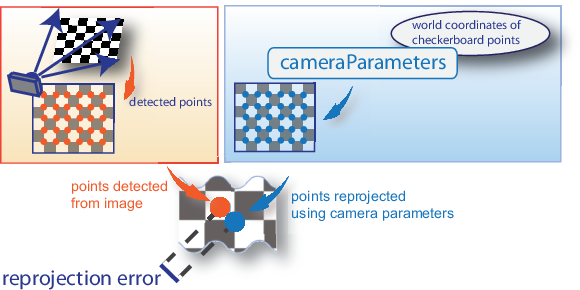

Mean reprojection error: 0.2777258585970696


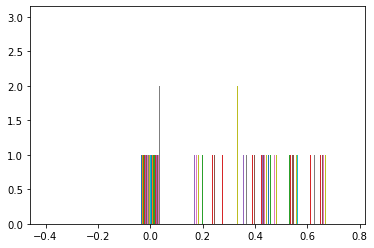

In [29]:
def reprojection_errors(x1,x2,P1,P2,X):
    
    x1_bar = np.dot(P1, X) # 3xN points
    x2_bar = np.dot(P2, X)
    
    x1_bar/=x1_bar[-1,:]
    x2_bar/=x2_bar[-1,:]

    dist1 = (x1_bar-x1)
    dist2 = (x2_bar-x2)
    
    err = dist1 + dist2    
    return err


err = reprojection_errors(x1,x2,P1,P2,X)
plt.hist(err,bins='auto')
err_mean = np.mean(err)
print(f'Mean reprojection error: {err_mean}')

**Q15.** Repeat all the process with your own images taken with your
camera. Try reconstructions for different pairs of images and comment the results
obtained.

## Q6 & Q15

### Reconstruction of full scene images

In [35]:
K = np.array([[4.70077566e+03, 9.80298734e+02, 6.78573364e-01],
       [0.00000000e+00, 4.26423524e+03, 4.09326521e-01],
       [0.00000000e+00, 0.00000000e+00, 1.00000000e+00]])

# define the principal funtion
def compute_all_reconstruction(img1_path, img2_path, th, max_it):
    kp1, kp2, des1, des2,matches = compute_kp_des(img1_path,img2_path)

    F, indices_inlier_matches, points1, points2 = robust_estimation_F(kp1, kp2, matches, img1_path, img2_path, th, max_it)
    m1, m2, m3 = choose_random_idx(indices_inlier_matches)

    l2, l1 = get_epipolar_lines(F, points1, points2)

    # show plots
    show_subplot(l1,l2,m1,m2,m3, points1, points2, img1_path, img2_path)

    l2_e, l1_e = get_epipolar_lines_from_e(F, points1, points2)

    # show plots
    I1, I2 = show_subplot(l1_e,l2_e,m1,m2,m3, points1, points2, img1_path, img2_path)

    ny1, nx1 = I1.size
    ny2, nx2 = I2.size

    x1 = points1[:,indices_inlier_matches]
    x2 = points2[:,indices_inlier_matches]

    E = compute_E(F, K, K_p)
    P1 = compute_P1(K)
    Pc2 = compute_P2(E, K)
    P2 = chose_right_P2(P1, Pc2, x1, x2)
    X = triangulate_all_matches(x1, x2, P1, P2, nx1, ny1, nx2, ny2)
    err = reprojection_errors(x1,x2,P1,P2,X)

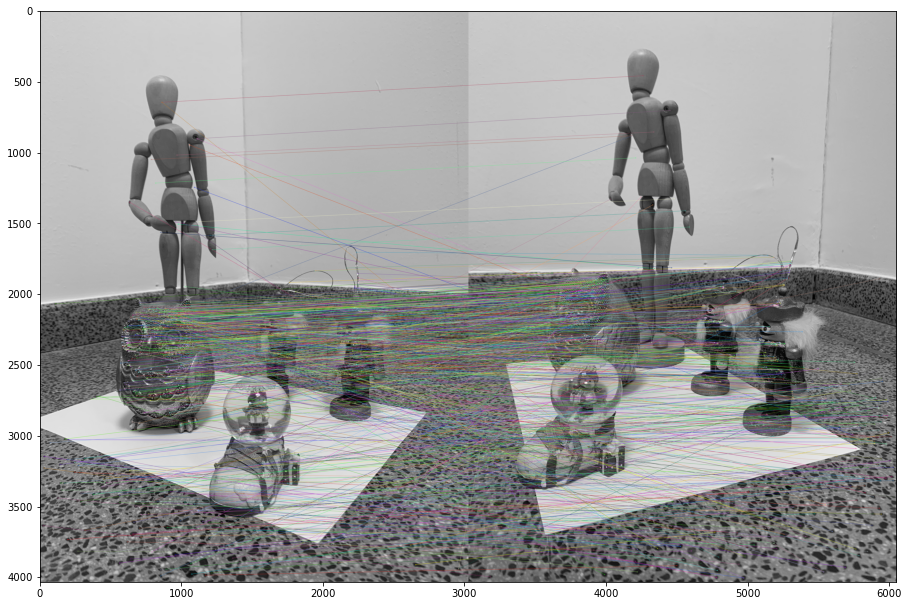

10000 110


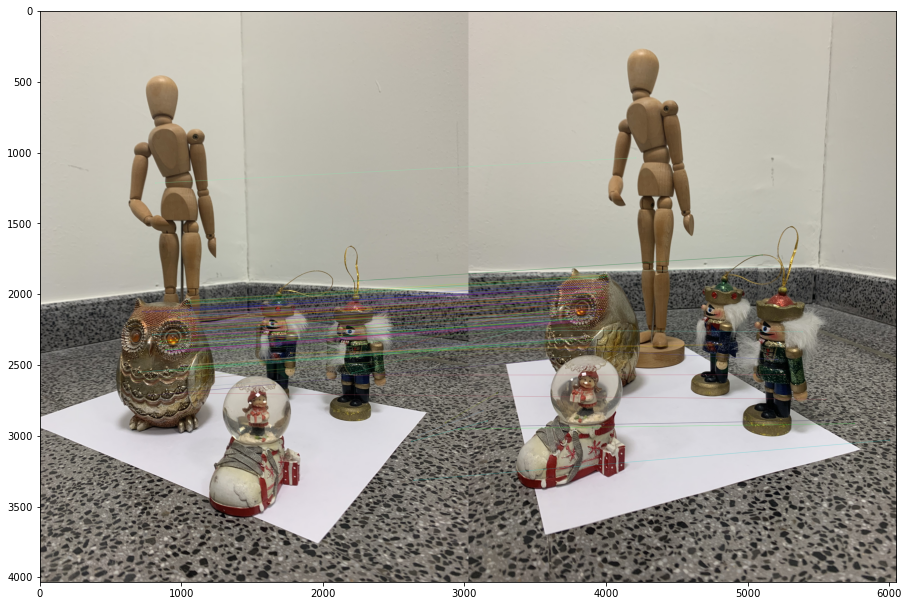

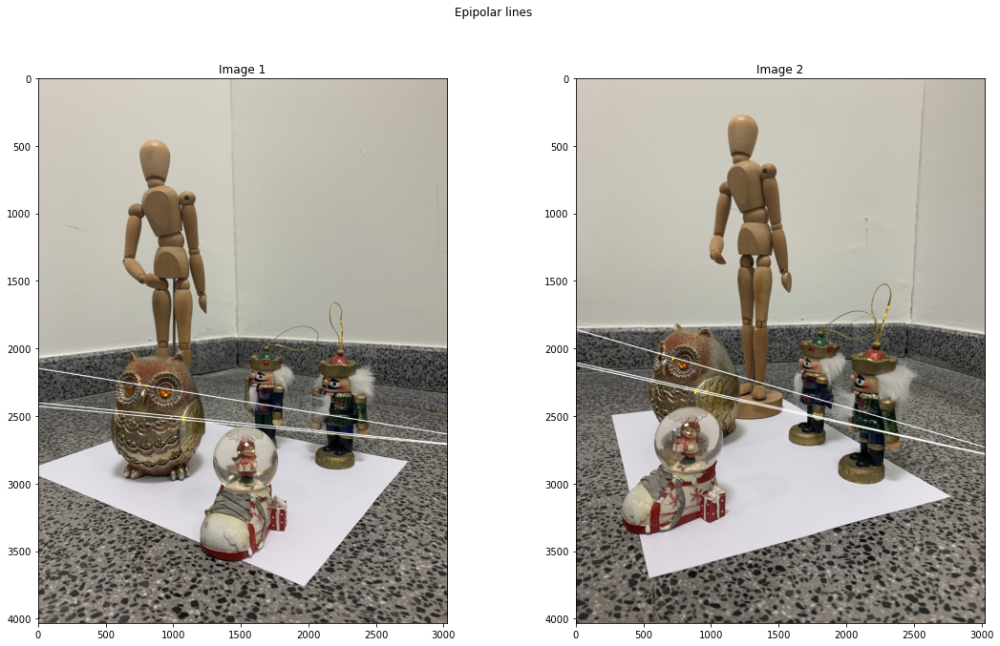

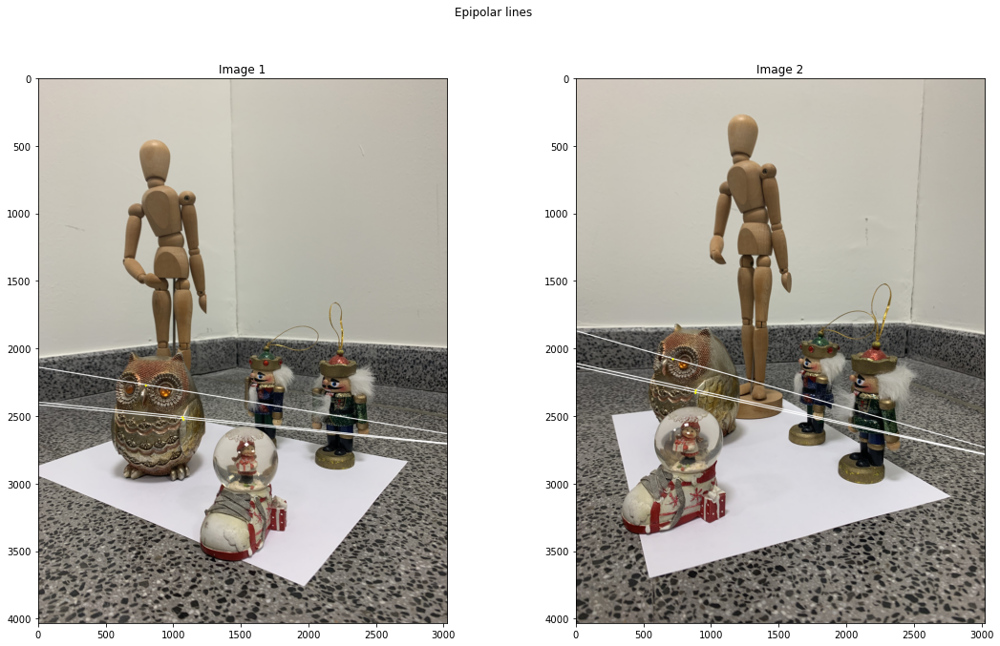

In [37]:
th = 50
max_it = 10000
img1_path,img2_path = 'own_images/img_1.jpg','own_images/img_2.jpg'

compute_all_reconstruction(img1_path, img2_path, th, max_it)


### Reconstruction of manikin images

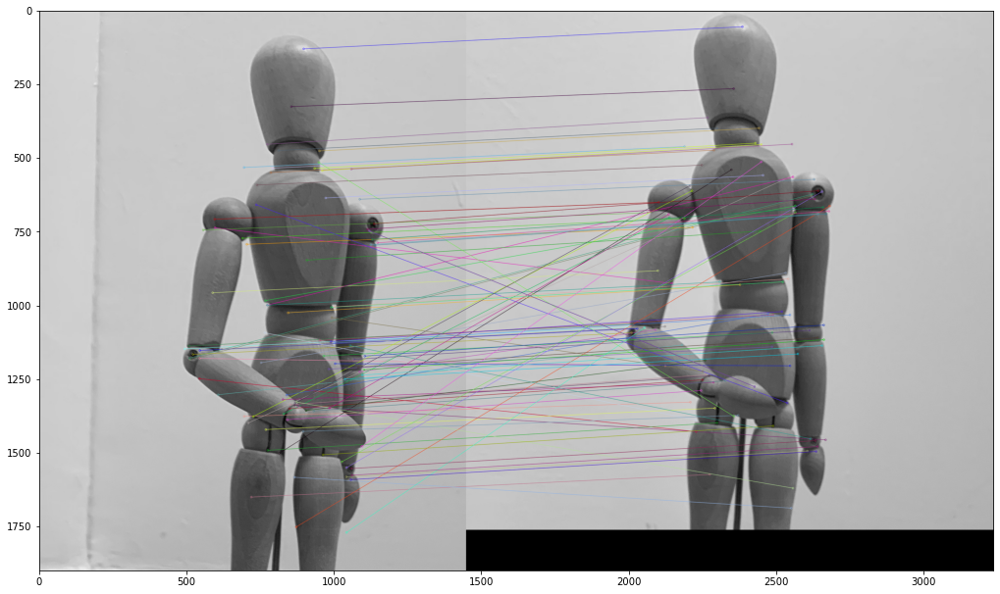

3999 45


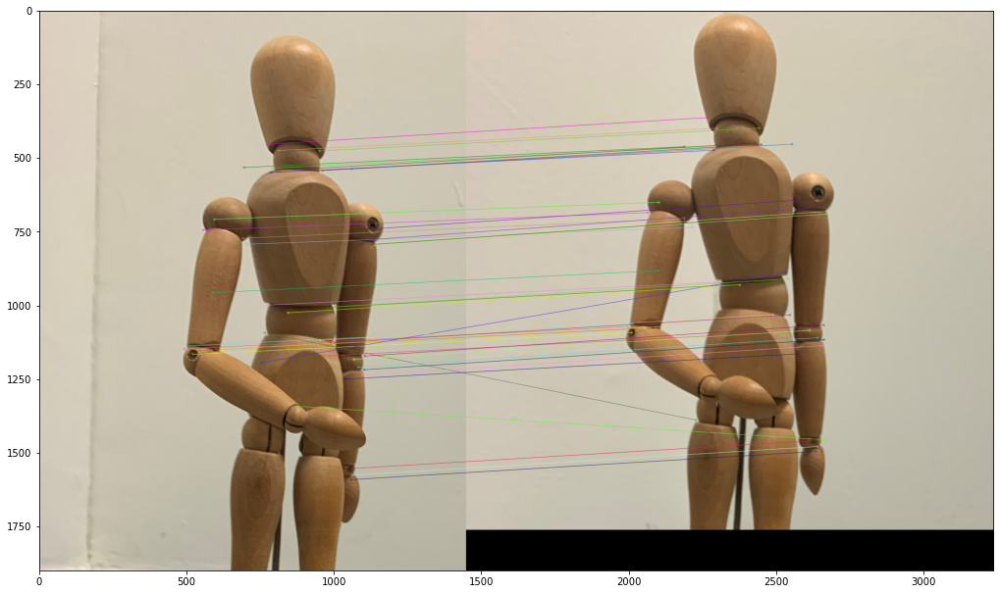

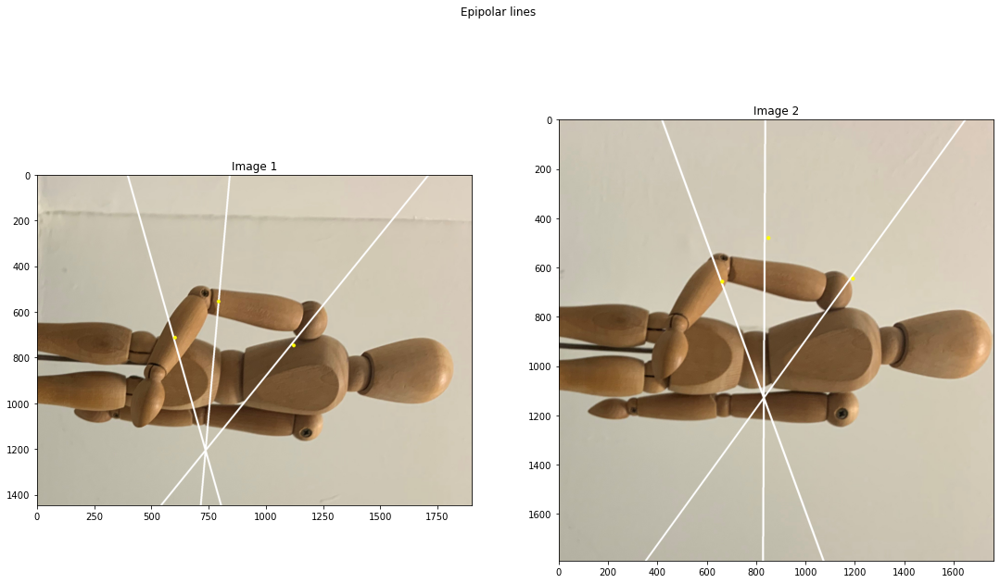

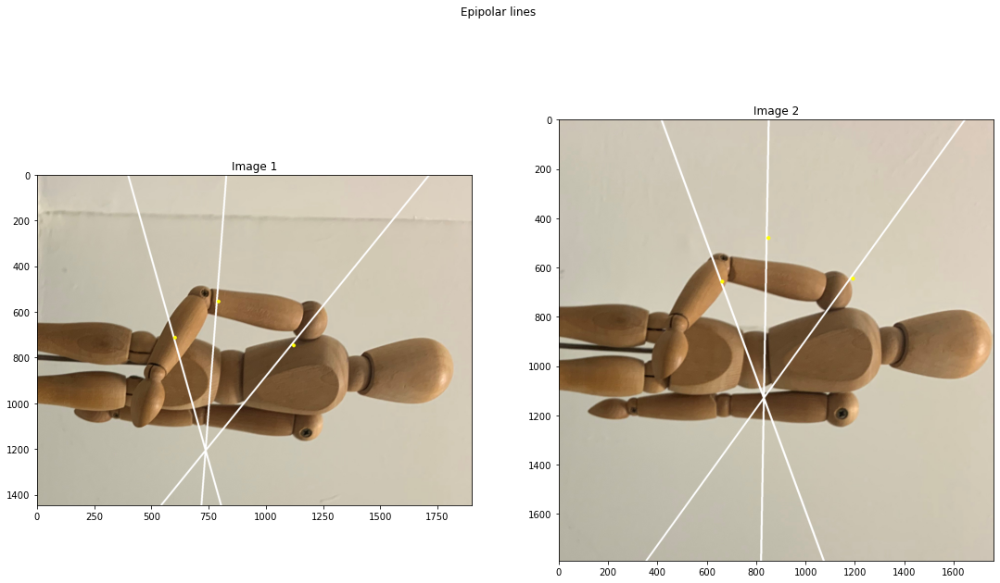

In [38]:
th = 50
max_it = 5000
img1_path,img2_path = 'own_images/img_16.jpg','own_images/img_17.jpg'
compute_all_reconstruction(img1_path, img2_path, th, max_it)


### Reconstruction of owl images

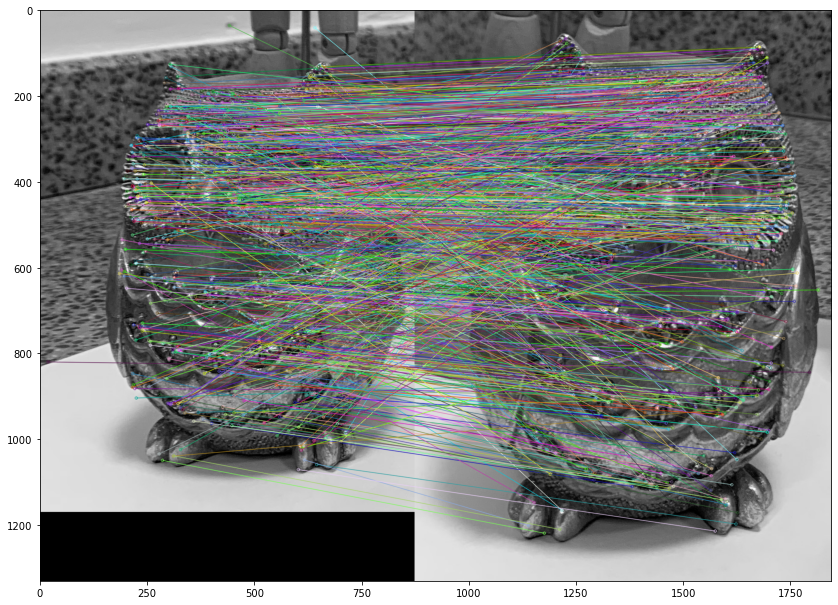

10000 288


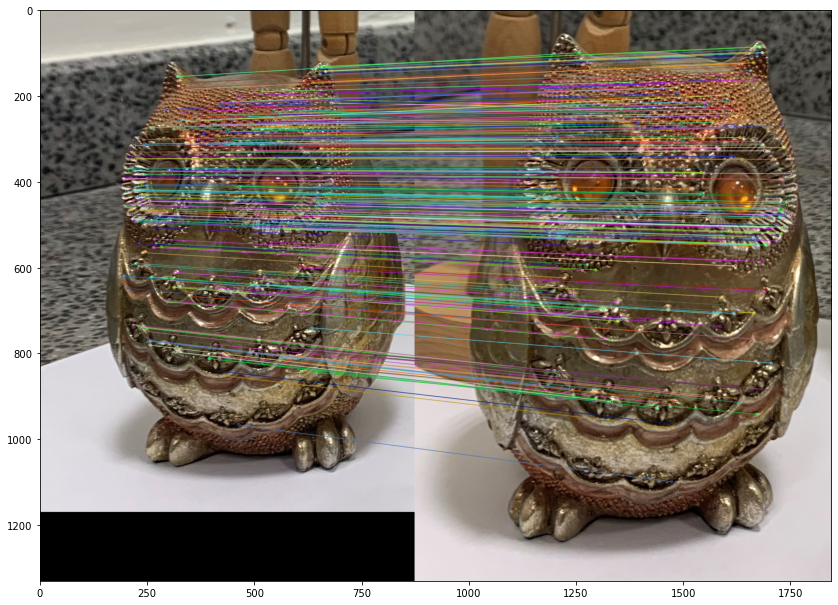

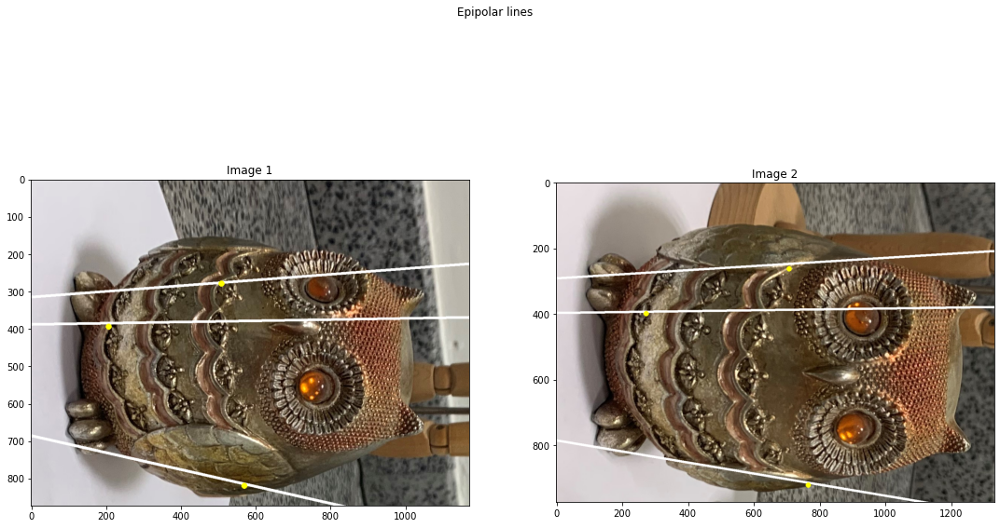

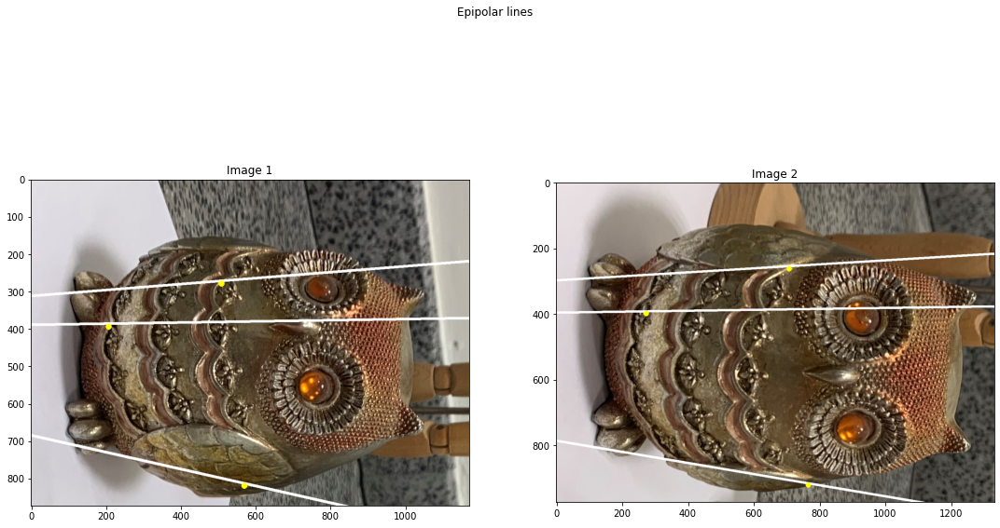

In [39]:
img1_path,img2_path = 'own_images/img_12.jpg','own_images/img_13.jpg'

compute_all_reconstruction(img1_path, img2_path, th, max_it)


### Reconstruction of little figures images

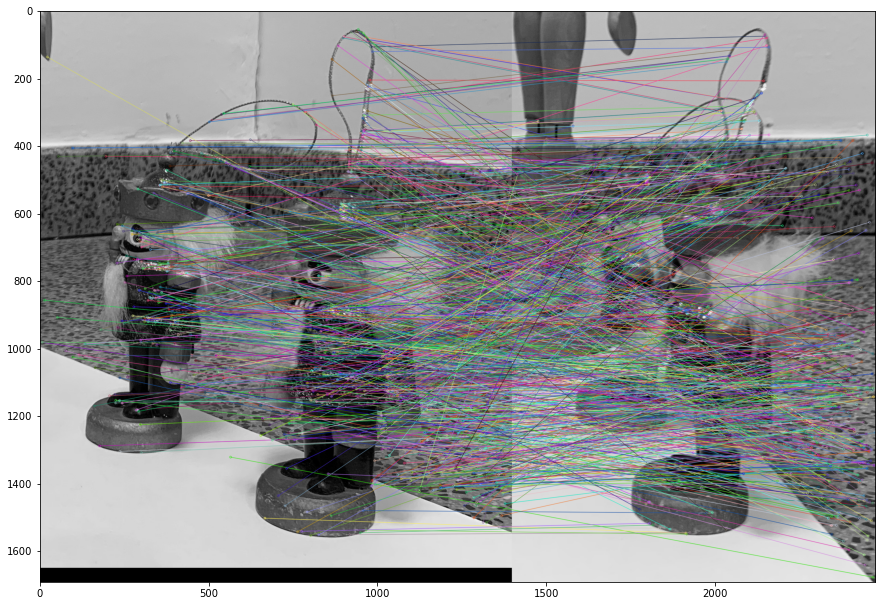

10000 67


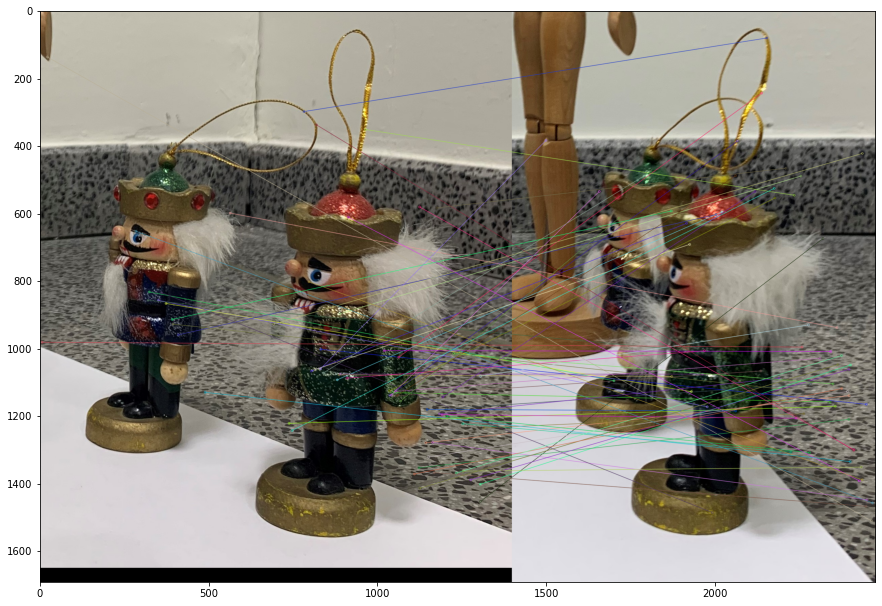

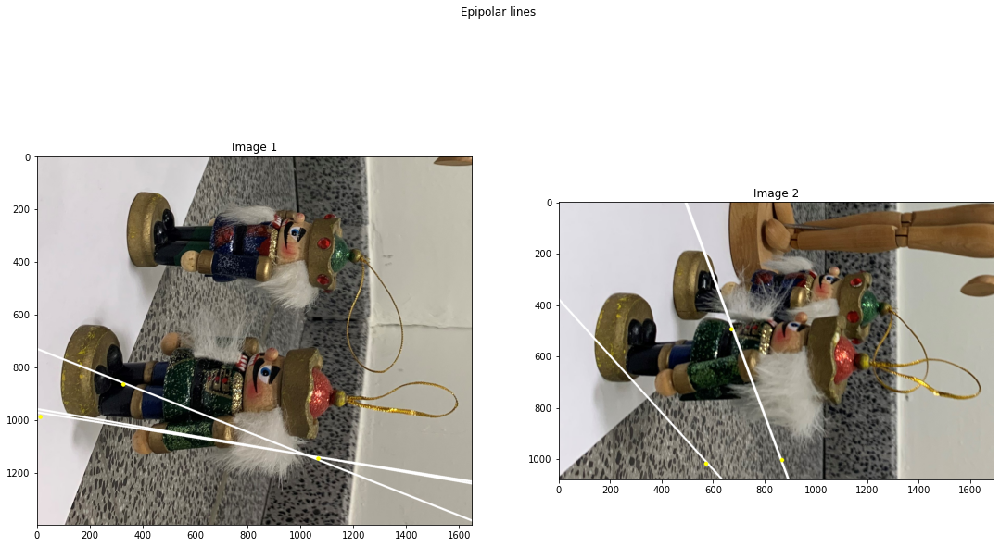

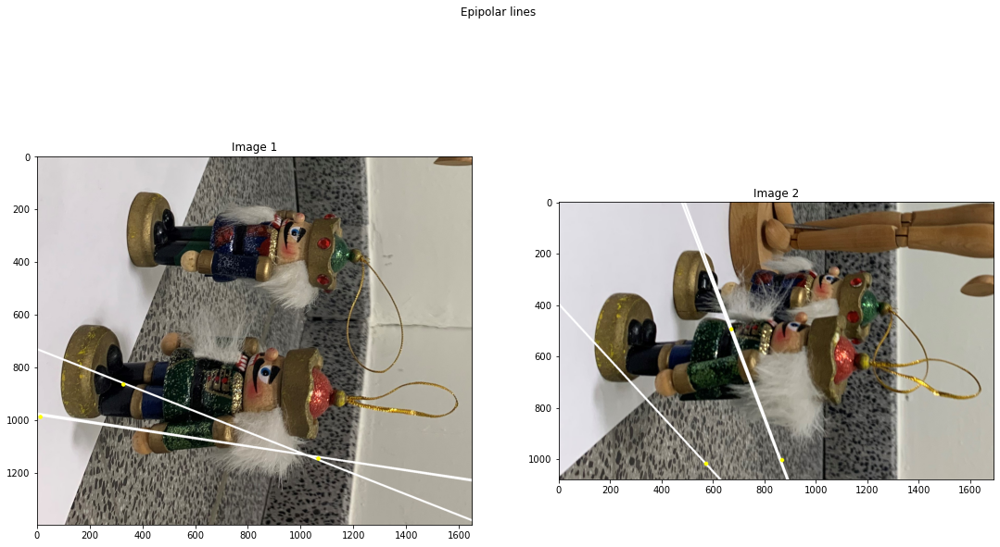

In [40]:
img1_path,img2_path = 'own_images/img_14.jpg','own_images/img_15.jpg'
compute_all_reconstruction(img1_path, img2_path, th, max_it)


<mark><font size=3>**Answer**</mark>

To compute the reconstruction of our own images, we needed to compute the K for the camera we are using, since its internal parameters are different from the ones of the camera that took the given photos. For this reason, we decided to copy the one we obtained in the last lab, since the camera is the same with same parameters and it is easier that copying all functions and computing it again.
    
First, we tried our method for all the objects in the scene and finally we focused on some objects in particular to check how it works. Even though, for the given example the reconstruction works quite well since the shape of the manikin can be sensed.
    
In the first case we notice that the estimation is not good, since there are lots of objects and it is difficult to distinguish to which one it corresponds each point. 
    
In the second case, even though we thought it might obtain some of the best results, we are not getting enough matches and therefore we cannot see a defined shape among the points. This might be because although the manikin has a singular shape it is very uniform in color terms, so it is quite difficult to find good correspondences. Also, we notice that the points are not located like they should, since they are more aligned than in the original image. 
    
In the third case the method is working better and we can distinguish some familiar shapes from the owl object, the most noticeable parts are the eyes and a bit of the body. Also, the number of correspondences is good enough.
    
In the forth case, since the change of view is to large the method is not capable of finding enough correspondences, and the ones found are mostly outliers. Therefore, the points cloud is not defined correctly.